<a href="https://colab.research.google.com/github/RyazMax/ML-in-IndustryLabs/blob/main/LW1/EDA%2Bmap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#0. Setup

In [1]:
!pip install geopandas
import os
import math
import datetime
from itertools import product
from operator import itemgetter, sub

import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import ipywidgets as wgs
from scipy import stats
from sklearn.preprocessing import MinMaxScaler
from shapely.geometry import Polygon

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.pipeline import make_pipeline

import folium
from folium.plugins import TimeSliderChoropleth
%matplotlib inline

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
sns.set_style("ticks")

# Largest Context:
sns.set_context("poster")
# plt.style.use('Solarize_Light2')

In [3]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [4]:
RS = 59

RES = '/content/drive/MyDrive/ITMO/3SEM/IndML/Lab1/industrial ml itmo/'
file_path = lambda file: os.path.join(RES, file)

## Original data

In [5]:
COORDS = ['lon', 'lat']
META = ['likescount', 'commentscount', 'symbols_cnt', 'words_cnt', 
        'hashtags_cnt', 'mentions_cnt', 'links_cnt', 'emoji_cnt']

In [6]:
train = pd.read_csv(file_path('train_data (1).csv'))
valid = pd.read_csv(file_path('valid.csv'))

Augment initial data

In [7]:
# Helpers

def xop(x, op) -> str:
  return f'{x}_{op}'

def get_tod(hr: int) -> str:
  assert 0 <= hr <= 23
  if hr < 6:
    return 'night'
  if hr < 12: 
    return 'morning'
  if hr < 18:
    return 'day'
  return 'evening'

def is_weekend(dow: int) -> str:
  assert 0 <= dow <= 6
  return 'weekend' if dow > 4 else 'weekday'

train['coords_tuple'] = list(train[['lon', 'lat']].itertuples(index=False))
train['date_time'] = pd.to_datetime(train['timestamp'], unit='s')

# extact meaningful info
train['date'] = train['date_time'].dt.date
train['hour'] = train['date_time'].dt.hour
train['is_weekend'] = train['date_time'].dt.dayofweek.apply(is_weekend)
train['time_of_day'] = train['hour'].apply(get_tod)

## Grouped data

In [8]:
agg_metrics = ['min', 'max', 'sum', 'mean']

### By hours

 Without coords

In [15]:
def get_data_by_hours(data):
  # group and aggregate
  groupers = ['date', 'hour']
  agg_condition = dict({'is_weekend': ('is_weekend', 'first'),
                            'time_of_day': ('time_of_day', 'first'),
                            'posts_count': (META[0], 'count')},
                            **{xop(x, op): (x, op) for x in META for op in agg_metrics})

  return data.groupby(groupers).agg(**agg_condition).reset_index()

In [16]:
train_by_hours = get_data_by_hours(train)

With coords

In [49]:
def get_data_by_hr_coord(data):
  groupers = ['lon', 'lat', 'date', 'hour']
  agg = 'sum'
  agg_condition = dict({xop(x, agg): (x, agg) for x in META},
                       is_weekend = ('is_weekend', 'first'),
                       time_of_day = ('time_of_day', 'first'),
                       date_time = ('date_time', 'first'),
                       publication = (META[0], 'count'))
  
  return data.groupby(groupers).agg(**agg_condition).reset_index()

In [50]:
train_hr_coord = get_data_by_hr_coord(train)

### By days

In [11]:
def get_data_by_days(data):
  agg_condition = dict({'is_weekend': ('is_weekend', 'first'),
                      'posts_count': (META[0], 'count')},
                     **{xop(x, op): (x, op) for x in META for op in agg_metrics})
  
  return data.groupby(data['date']).agg(**agg_condition).reset_index()

In [12]:
train_by_days = get_data_by_days(train)

# 1. EDA

### Info

In [ ]:
print(f'Shape of train data set: {train.shape}'
      f'\nShape of test data set: {valid.shape}')

In [ ]:
train.head(15)

,timestamp,lon,lat,likescount,commentscount,symbols_cnt,words_cnt,hashtags_cnt,mentions_cnt,links_cnt,emoji_cnt,point,date_time,date,hour,is_weekend,time_of_day,cls,coords_tuple
0,1565607600,30.329370,59.940488,63,4,52,6,0,0,0,0,0101000020E6100000DBC1F19351543E4006FC5DE561F8...,2019-08-12 11:00:00,2019-08-12,11,weekday,morning,0,"(30.32936978008534, 59.94048754777036)"
1,1565568000,30.342845,59.869542,44,0,40,0,4,0,0,0,0101000020E6100000544263A8C4573E40C27FCF284DEF...,2019-08-12 00:00:00,2019-08-12,0,weekday,night,0,"(30.342844509347128, 59.8695422185115)"
2,1565568000,30.322632,60.039332,30,0,77,7,0,0,0,1,0101000020E61000009E01B90998523E40888919D70805...,2019-08-12 00:00:00,2019-08-12,0,weekday,night,0,"(30.322632415454446, 60.03933228251395)"
3,1565568000,30.322632,59.938238,13,0,634,17,32,0,0,7,0101000020E61000009E01B90998523E40CEB8CE2B18F8...,2019-08-12 00:00:00,2019-08-12,0,weekday,night,5,"(30.322632415454446, 59.93823764413683)"
4,1565568000,30.309158,59.932612,8,0,0,0,0,0,0,0,0101000020E6100000268147F5244F3E40494A4ED65FF7...,2019-08-12 00:00:00,2019-08-12,0,weekday,night,0,"(30.30915768619265, 59.932612217166536)"
5,1565568000,30.495558,59.859395,80,0,17,0,0,1,0,0,0101000020E61000000C9D69E5DC7E3E404EFE0BA600EE...,2019-08-12 00:00:00,2019-08-12,0,weekday,night,0,"(30.495558107647447, 59.85939479432693)"
6,1565568000,30.219326,59.973094,123,0,2,0,0,0,0,2,0101000020E610000050D352C225383E4030E11C588EFC...,2019-08-12 00:00:00,2019-08-12,0,weekday,night,0,"(30.2193261577807, 59.97309399995937)"
7,1565568000,30.315895,59.941612,15,0,29,4,0,0,0,1,0101000020E61000006141807FDE503E406DAFAAC186F8...,2019-08-12 00:00:00,2019-08-12,0,weekday,night,0,"(30.315895050823546, 59.94161244234315)"
8,1565568000,30.322632,60.039332,213,0,126,14,0,0,0,1,0101000020E61000009E01B90998523E40888919D70805...,2019-08-12 00:00:00,2019-08-12,0,weekday,night,0,"(30.322632415454446, 60.03933228251395)"
9,1565568000,30.241784,59.924735,106,6,253,25,1,0,0,0,0101000020E6100000C5FE0F8FE53D3E4033438EB75DF6...,2019-08-12 00:00:00,2019-08-12,0,weekday,night,0,"(30.24178403988369, 59.92473501631175)"


In [ ]:
train.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8526526 entries, 0 to 8526525
Data columns (total 12 columns):
 #   Column         Non-Null Count    Dtype  
---  ------         --------------    -----  
 0   timestamp      8526526 non-null  int64  
 1   lon            8526526 non-null  float64
 2   lat            8526526 non-null  float64
 3   likescount     8526526 non-null  int64  
 4   commentscount  8526526 non-null  int64  
 5   symbols_cnt    8526526 non-null  int64  
 6   words_cnt      8526526 non-null  int64  
 7   hashtags_cnt   8526526 non-null  int64  
 8   mentions_cnt   8526526 non-null  int64  
 9   links_cnt      8526526 non-null  int64  
 10  emoji_cnt      8526526 non-null  int64  
 11  point          8526526 non-null  object 
dtypes: float64(2), int64(9), object(1)
memory usage: 780.6+ MB


### Histograms

In [19]:
def widgets(tab_names, plot_func, params):
  assert len(tab_names) == len(params)
  tabs = [wgs.Output() for _ in range(len(tab_names))]
  tab = wgs.Tab(children = tabs)
  for i, name in enumerate(tab_names):
    tab.set_title(i, name)
  
  display(tab)
  for _tab, param in zip(tabs, params):
    with _tab:
      plot_func(*param)

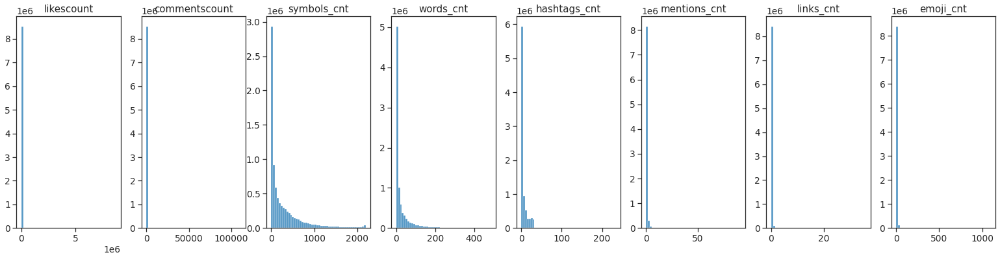

In [10]:
# sns.histplot(train[META], kde=True)
sns.set_context("notebook", font_scale=1.25)
plt.figure(figsize=(27, 6))
for i, n in enumerate(META):
  plt.subplot(1, 8, i + 1)
  sns.histplot(train, x=n, bins=50, legend=False)
  # plt.hist(list(train[n]), 10, density=True, alpha=.75, label=n, stacked=True)
  plt.xlabel('')
  plt.ylabel('')
  plt.title(n)

plt.show()

Looks like all meta data column values have $exp$ distribution.

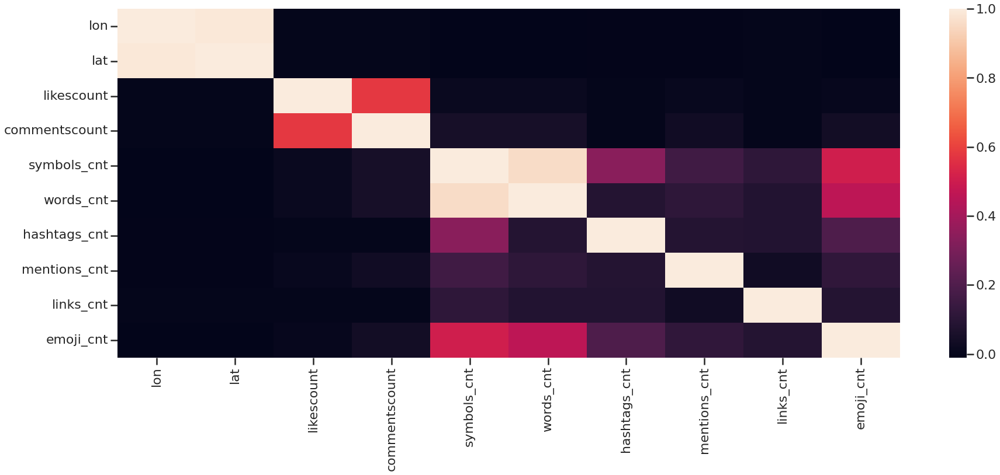

In [156]:
fig = plt.figure(figsize=(30, 11))
sns.heatmap(train[['lon', 'lat'] + META].corr())
plt.show(fig)

Insights:
*   `likescount` and `commentscount` have the biggest correlation. These features can be told to represent <i>human interest in this post</i>.
*   `likescount` and `commentscount` have no correlation with other columns, this means that people's reaction doesn't depend on formal characteristics of posts. Probably, it mostly depens on it actual content.
*   The least correlation is <i>human interest features</i> have is with `links` and `hashtags`. This can mean that people don't search posts by hashtags.



### Augment data

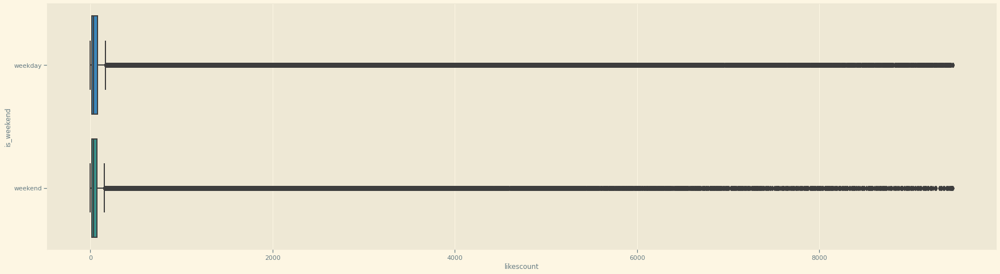

In [ ]:
plt.figure(figsize=(30, 8))
sns.boxplot(data=train[stats.zscore(train['likescount']) < 3], x='likescount', y='is_weekend')

The pure data looks very broab, try grouping it.

## Weekday - weekend

In [ ]:
train_by_days.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396 entries, 0 to 395
Data columns (total 19 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   date_time           396 non-null    object 
 1   is_weekend          396 non-null    object 
 2   posts_count         396 non-null    int64  
 3   likescount-sum      396 non-null    int64  
 4   likescount-mean     396 non-null    float64
 5   commentscount-sum   396 non-null    int64  
 6   commentscount-mean  396 non-null    float64
 7   symbols_cnt-sum     396 non-null    int64  
 8   symbols_cnt-mean    396 non-null    float64
 9   words_cnt-sum       396 non-null    int64  
 10  words_cnt-mean      396 non-null    float64
 11  hashtags_cnt-sum    396 non-null    int64  
 12  hashtags_cnt-mean   396 non-null    float64
 13  mentions_cnt-sum    396 non-null    int64  
 14  mentions_cnt-mean   396 non-null    float64
 15  links_cnt-sum       396 non-null    int64  
 16  links_cn

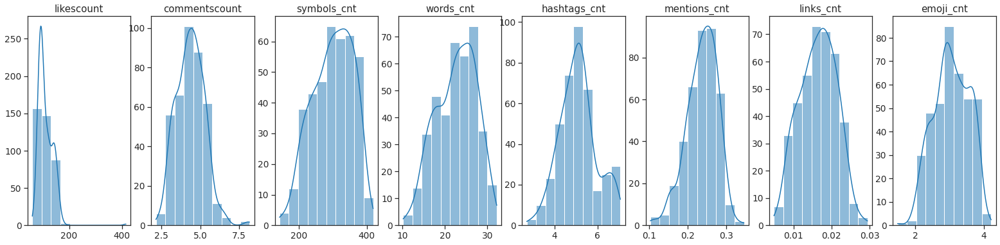

In [14]:
sns.set_context("notebook", font_scale=1.25)
plt.figure(figsize=(27, 6))
for i, n in enumerate(META):
  plt.subplot(1, 8, i + 1)
  sns.histplot(train_by_days, x=xop(n, 'mean'), bins=10, legend=False, kde=True)
  # plt.hist(list(train[n]), 10, density=True, alpha=.75, label=n, stacked=True)
  plt.xlabel('')
  plt.ylabel('')
  plt.title(n)

plt.show()

In [ ]:
def hist_func(op):
  plt.figure(figsize=(28, 14))
  for i, n in enumerate(META):
    plt.subplot(2, 4, i + 1)
    plt.hist(list(train_by_days[xop(n, op)]), 10, density=True, alpha=.75, label=n, stacked=True)
    plt.title(xop(n, op))
    plt.legend()
  plt.show()

widgets(['Total data per day', 'Average data per day'],
        hist_func,
        [('sum',), ('mean',)])

### Boxplots

In [23]:
sns.set_context('notebook', font_scale=1.75)
def boxplots_func(agg):
  fig = plt.figure(figsize=(28, 14))
  plt.subplot(2, 4, 1)
  plt.title('posts count')
  sns.boxplot(data=train_by_days, x='posts_count', y='is_weekend')
  plt.yticks(rotation=90)
  plt.xlabel('')
  plt.ylabel('')
  for i, col in enumerate(META[:-1]): # skip last meta info to fit in 4x2 display grid
    plt.subplot(2, 4, i+2)
    sns.boxplot(data=train_by_days, x=xop(col, agg), y='is_weekend')
    plt.yticks(rotation=90)
    plt.xlabel('')
    plt.ylabel('')
    plt.title(col)
  plt.show(fig)

widgets(['Total data per day', 'Average data per day'],
        boxplots_func,
        [('sum',), ('mean',)])

Insights:

*   In average, people post more on weekend
*   Weekday posts have richer structure, while weekend posts can be less well thought out
*   Probably, weekend posts are mainly made by authors for themselves (for memories), and weekdays - for followers (communication with audience)



### Cross-correlation

In [ ]:
def xcorr_func(op):
  fig = plt.figure(figsize=(28, 14))
  dat = train_by_days \
          if op == 'all' \
          else train_by_days[['posts_count'] + [xop(x, op) for x in META]]
  sns.heatmap(dat.corr())
  plt.show(fig)

widgets(['XCorrelation all', 'XCorrelation sum agg', 'XCorrelation avg agg'],
        xcorr_func,
        [('all',), ('sum',), ('mean',)])

### Pairplots

In [ ]:
def pairplot(op, kind):
  fig = plt.figure()
  sns.pairplot(data=train_by_days[['is_weekend', 'posts_count'] + [xop(x, op) for x in META]].reset_index(), 
                palette='Spectral', 
                hue='is_weekend', 
                kind=kind)
  plt.show(fig)

def pairplot_tab(n):
  if n == 'sum':
    widgets(['Hist', 'KDE'],
            pairplot,
            [('sum', 'hist'),
             ('sum', 'kde')]) 
  elif n == 'mean':
    widgets(['Hist', 'KDE'],
            pairplot,
            [('mean', 'hist'),
             ('mean', 'kde')])

widgets(['Sum pairplots', 'Mean pairplots'],
        pairplot_tab,
        [('sum',),('mean',)])

## Lon-lat-date-hour

In [ ]:
# ,_____________________________________________________________,
# *______________________________________________________[_][x]_*
# |                      -----------------                      |
# |                       already defined                       |
# |                        just reminder                        |
# |                      -----------------                      |
# |                                                             |
# |                   [/CANCEL/]    [   OK   ]                  |
# *_____________________________________________________________*


In [ ]:
train_by_hours.columns

Index(['date', 'hour', 'is_weekend', 'posts_count', 'likescount-min',
       'likescount-max', 'likescount-sum', 'likescount-mean',
       'commentscount-min', 'commentscount-max', 'commentscount-sum',
       'commentscount-mean', 'symbols_cnt-min', 'symbols_cnt-max',
       'symbols_cnt-sum', 'symbols_cnt-mean', 'words_cnt-min', 'words_cnt-max',
       'words_cnt-sum', 'words_cnt-mean', 'hashtags_cnt-min',
       'hashtags_cnt-max', 'hashtags_cnt-sum', 'hashtags_cnt-mean',
       'mentions_cnt-min', 'mentions_cnt-max', 'mentions_cnt-sum',
       'mentions_cnt-mean', 'links_cnt-min', 'links_cnt-max', 'links_cnt-sum',
       'links_cnt-mean', 'emoji_cnt-min', 'emoji_cnt-max', 'emoji_cnt-sum',
       'emoji_cnt-mean'],
      dtype='object')

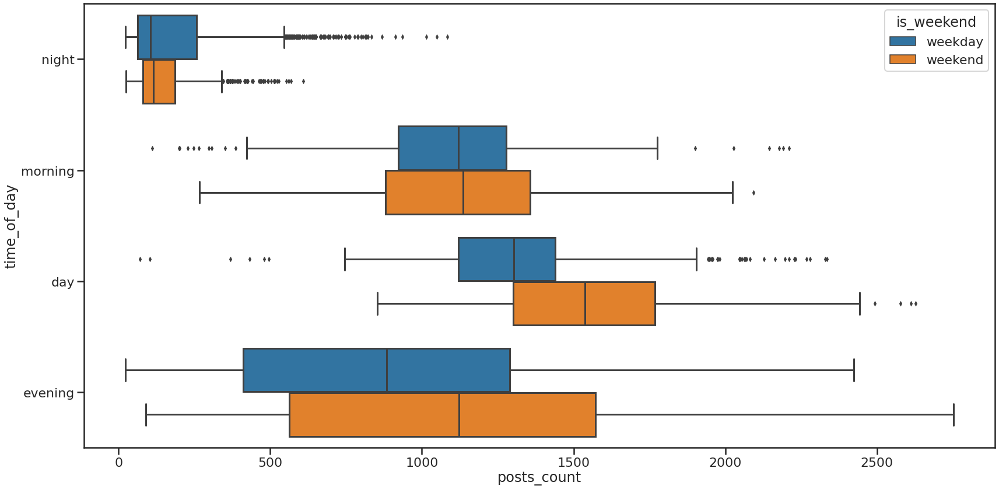

In [17]:
plt.figure(figsize=(28, 14))
sns.set_context('poster')
sns.boxplot(data=train_by_hours, 
            x='posts_count', 
            y='time_of_day', 
            hue='is_weekend')

In [ ]:
def hist_func_2(op):
  plt.figure(figsize=(30, 15))
  plt.subplot(3, 3, 1)
  plt.hist(list(train_by_hours['posts_count']), 50, density=True, alpha=.75, label='posts_count')
  plt.title('posts_count')
  plt.legend()

  for i, n in enumerate(META):
    plt.subplot(3, 3, i + 2)
    plt.hist(list(train_by_hours[xop(n, op)]), 50, density=True, alpha=.75, label=n)
    plt.title(xop(n, op))
    plt.legend()
  plt.show()

widgets([f'agg: {x}' for x in agg_metrics],
        hist_func_2,
        [(x,) for x in agg_metrics])

In [ ]:
def xcorr_func(op):
  fig = plt.figure(figsize=(30, 15))
  sns.heatmap(train_by_hours[['posts_count'] + [xop(x, op) for x in META]].corr())
  plt.show(fig)

widgets([f'XCorrelation {x}' for x in agg_metrics],
        xcorr_func,
        [(x,) for x in agg_metrics])

# 2. Map

Load data

In [130]:
nice_grouped = pd.read_csv(file_path('nice_grouped.csv'))

In [131]:
nice_grouped.head(15)

,point,lat,lon,timestamp,publication
0,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1574420400,1
1,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1574424000,1
2,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1574514000,1
3,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1574697600,1
4,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1574848800,1
5,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1575021600,1
6,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1575108000,1
7,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1575201600,1
8,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1575219600,1
9,0101000020E610000002A5EC7AB31D3E4097654065F8EA...,59.835705,30.11602,1575277200,1


In [132]:
nice_grouped['coords_tuple'] = list(nice_grouped[['lon', 'lat']].itertuples(index=False))
nice_grouped['date_time'] = pd.to_datetime(nice_grouped['timestamp'], unit='s')

Transform points to geojson squares<br/>
for marking squares, let's define meter to coordinates converter

In [149]:
# Earth radius
R = 6378137

def point_square(point, size = (250, 250)):
  lat, lon = point
  size_lat, size_lon = size

  return (coord_offset((lat, lon), (-size_lat/2, -size_lon/4)),
          coord_offset((lat, lon), (-size_lat/2, size_lon/4)),
          coord_offset((lat, lon), (size_lat/2, size_lon/4)),
          coord_offset((lat, lon), (size_lat/2, -size_lon/4)))
  
def coord_offset(point_coord: tuple, offset_meters: tuple):
  lat, lon = point_coord
  d_lat, d_lon = offset_meters
  d_lat = d_lat/R
  d_lon = d_lon/(R*math.cos(math.pi*lat/180))


  latO = lat + d_lat * 180/math.pi
  lonO = lon + d_lon * 180/math.pi

  return latO, lonO

def time_slider_choropleth(data: pd.DataFrame, window: int = None, cmap = "#272727"):
  """
  data - pandas DataFrame, should contain:
    lon-lat "coords_tuple",
    "publication" counts,
    and evenly distributed "date_time" for all coords
  window: int = None - how much timeslots to aggregate, if needed. default - no aggregation
  cmap - color map. Hex color code or function to get color palette of specified length
  """
  data_ = data.loc[:, ['coords_tuple', 'date_time', 'publication']]

  # geojson
  points = pd.DataFrame(pd.unique(data_['coords_tuple']), columns=['coords_tuple']).reset_index()
  points['poly'] = points['coords_tuple'].apply(point_square)
  points['geometry'] = points['poly'].apply(Polygon)
  gdf_ = gpd.GeoDataFrame(points, crs="EPSG:4326")

  del points

  # style dict
  data_['opacity'] = MinMaxScaler().fit_transform(data_['publication'].to_numpy().reshape(-1,1))
  data_['opacity'] = data_['opacity'].apply(lambda x: 1 if x else 0)
  if window:
    s = data_.groupby('coords_tuple')['opacity'].rolling(window).agg('mean').fillna(0)
    s.index = data_.index
    data_['opacity'] = s
  colors = list(range(5))#list(sorted(list(pd.unique(data_['publication']))))
  colors = {p: id for id, p in enumerate(colors)}
  colors_n = len(colors)
  # max_color = data_['publication'].max() + 1
  colormap = cmap(len(colors)) if callable(cmap) else cmap
  data_['color'] = colormap if isinstance(colormap, str) else data_['publication'].apply(lambda x: colormap[colors[x]] if x < colors_n else colormap[-1])
  data_['u10_dt'] = (data_['date_time'].astype(int) // 10 ** 9).astype("U10")
  style_dict_ = {str(id): data_[data_['coords_tuple'] == coord]
                    .set_index('u10_dt')[['opacity', 'color']]
                    .to_dict('index')
                for id, coord in gdf_['coords_tuple'].iteritems()}
  
  # map
  m = folium.Map(location=(59.93863, 30.31413), tiles=None, zoom_start=12)
  folium.TileLayer("stamentoner").add_to(m)

  name = f'Choropleth {data["date_time"].min()}'

  g = TimeSliderChoropleth(
      gdf_.to_json(),
      styledict=style_dict_,
      name = name
  ).add_to(m)
  folium.LayerControl(collapsed=False).add_to(m)
  
  return m

## One day
Expore total per-hour post activity in ine day

In [142]:
# custom pandas datetime descrption
def describe_datetime(datetime):
  return (str(datetime) 
    + f'\nday of year: {datetime.day_of_year}'
    f'\nweek of year: {datetime.weekofyear}'
    f'\nquarter: {datetime.quarter}')

Choose the day...
<br/>...randomly

In [135]:
# fix random state
np.random.seed(RS)

dt = pd.to_datetime(np.random.choice(pd.unique(nice_grouped['date_time'].dt.date)))
dt_describtion = describe_datetime(dt)
print(dt_describtion)

2019-10-07 00:00:00
day of year: 280
week of year: 41
quarter: 4


In [136]:
day_info = nice_grouped[nice_grouped['date_time'].dt.date == dt.date()].reset_index()

#
# TODO: Introduce function
#

# def create_interval(start, )

# prepare index
ind_dates = pd.Series(pd.date_range(dt.date(), dt.date() + pd.DateOffset(hours=23), freq='1H'), name='date_time')
ind_coords = pd.Series(pd.unique(day_info['coords_tuple']), name='coords_tuple')

# failed to reindex with multiindex, so merge in tuple
day_info['index'] = list(day_info[['coords_tuple', 'date_time']].itertuples(index=False))
day_info = day_info.set_index('index')
# day_info = day_info.set_index(['coords_tuple', 'date_time'])
day_info = day_info.reindex(list(pd.merge(ind_coords, ind_dates, how='cross').itertuples(index=False)))
day_info = day_info.loc[:, ['publication']]
day_info = day_info.reset_index()
day_info['coords_tuple'], day_info['date_time'] = zip(*list(day_info['index']))
day_info.drop(['index'], axis='columns', inplace=True)
day_info['publication'] = day_info['publication'].fillna(0, axis='index').astype(int)
day_info.head(15)

,publication,coords_tuple,date_time
0,0,"(30.248521404514584, 59.904470767018296)",2019-10-07 00:00:00
1,0,"(30.248521404514584, 59.904470767018296)",2019-10-07 01:00:00
2,0,"(30.248521404514584, 59.904470767018296)",2019-10-07 02:00:00
3,0,"(30.248521404514584, 59.904470767018296)",2019-10-07 03:00:00
4,0,"(30.248521404514584, 59.904470767018296)",2019-10-07 04:00:00
5,0,"(30.248521404514584, 59.904470767018296)",2019-10-07 05:00:00
6,0,"(30.248521404514584, 59.904470767018296)",2019-10-07 06:00:00
7,0,"(30.248521404514584, 59.904470767018296)",2019-10-07 07:00:00
8,1,"(30.248521404514584, 59.904470767018296)",2019-10-07 08:00:00
9,0,"(30.248521404514584, 59.904470767018296)",2019-10-07 09:00:00


In [150]:
time_slider_choropleth(day_info, 2, cmap = lambda n: sns.color_palette('rocket_r', n).as_hex())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:57: FutureWarning: casting datetime64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.


In [140]:
day_info['publication'].value_counts()

0     48304
1      6569
2      1906
3       838
4       486
5       295
6       172
7       137
8        95
9        85
10       57
11       41
12       34
13       25
15       19
17       19
14       19
16       17
19       13
18       13
20       12
21        9
23        8
25        7
22        5
30        4
33        3
27        3
36        3
24        3
35        3
34        2
31        2
41        2
32        2
40        2
47        2
29        2
26        2
28        2
46        2
49        1
37        1
64        1
71        1
65        1
42        1
53        1
39        1
Name: publication, dtype: int64

## Per-hour in one day average for year without window

In [ ]:
def get_avg_by_hour_year():  
  first_day = pd.to_datetime(nice_grouped['date_time'].min().date())
  last_day = first_day + pd.Timedelta(365, 'days')
  info_ = nice_grouped[nice_grouped['date_time'].dt.date < last_day] 
  info_['hour'] = info_['date_time'].dt.hour
  info_ = info_.groupby(['coords_tuple', 'hour']) \
               .agg(publication = ('publication', 'mean')) \
               .reset_index()
  info_['date_time'] = info_['hour'].apply(lambda x: pd.Timedelta(x, 'H') + first_day)
  info_.drop(['hour'], axis='columns', inplace=True)

  # prepare index
  ind_dates = pd.Series(name = 'date_time',
                        data = pd.date_range(first_day, first_day+pd.DateOffset(hours=23), freq='1H'))
  ind_coords = pd.Series(pd.unique(info_['coords_tuple']), name='coords_tuple')

  # failed to reindex with multiindex, so merge in tuple
  info_['index'] = list(info_[['coords_tuple', 'date_time']].itertuples(index=False))
  info_ = info_.set_index('index')
  # info_ = info_.set_index(['coords_tuple', 'date_time'])
  # info_ = info_.reindex(list(pd.merge(ind_coords, ind_dates, how='cross').itertuples(index=False)))
  info_ = info_.loc[:, ['publication']]
  info_ = info_.reset_index()
  info_['coords_tuple'], info_['date_time'] = zip(*list(info_['index']))
  info_.drop(['index'], axis='columns', inplace=True)
  info_['publication'] = info_['publication'].fillna(0, axis='index').astype(int)
  return info_

In [ ]:
avg_daily_y = get_avg_by_hour_year()
time_slider_choropleth(avg_daily_y, cmap = "#000000")

/usr/local/lib/python3.7/dist-packages/pandas/core/ops/array_ops.py:73: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior.  In a future version these will be considered non-comparable.Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  result = libops.scalar_compare(x.ravel(), y, op)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:54: FutureWarning: casting datetime64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.


## Total per month in a year
To capture whether shift exists over months

In [ ]:
def get_avg_per_month_year():  
  first_day = pd.to_datetime(nice_grouped['date_time'].min().date())
  last_day = first_day + pd.Timedelta(365, 'days')
  info_ = nice_grouped[nice_grouped['date_time'].dt.date < last_day] 
  info_['month'] = info_['date_time'].dt.month
  info_ = info_.groupby(['coords_tuple', 'month']) \
               .agg(publication = ('publication', 'sum')) \
               .reset_index()
  info_['date_time'] = info_['month'] \
    .apply(lambda x: pd.to_datetime(f'{x}/01/{first_day.year}', infer_datetime_format=True))
  info_.drop(['month'], axis='columns', inplace=True)

  # prepare index
  ind_dates = pd.Series(name = 'date_time',
                        data = pd.date_range(first_day, last_day, freq='MS'))
  ind_coords = pd.Series(pd.unique(info_['coords_tuple']), name='coords_tuple')

  # failed to reindex with multiindex, so merge in tuple
  info_['index'] = list(info_[['coords_tuple', 'date_time']].itertuples(index=False))
  info_ = info_.set_index('index')
  # info_ = info_.set_index(['coords_tuple', 'date_time'])
  # info_ = info_.reindex(list(pd.merge(ind_coords, ind_dates, how='cross').itertuples(index=False)))
  info_ = info_.loc[:, ['publication']]
  info_ = info_.reset_index()
  info_['coords_tuple'], info_['date_time'] = zip(*list(info_['index']))
  info_.drop(['index'], axis='columns', inplace=True)
  info_['publication'] = info_['publication'].fillna(0, axis='index').astype(int)
  return info_

In [ ]:
avg_month_y = get_avg_per_month_year()
time_slider_choropleth(avg_month_y, cmap = "#000000")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:54: FutureWarning: casting datetime64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.


# Clustering

## K-means
Pipeline: `X` -> `Standard Scaler` -> `K-Means` -> `y`

### Elbow method

#### Initial data


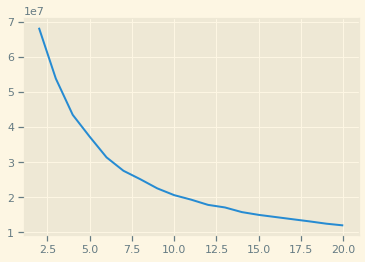

In [ ]:
CLUSTERS_GRID = np.linspace(2, 20, 19).astype('int')

kmeans_pipes = []
qual = []

for cl in CLUSTERS_GRID:
  kmeans_pipeline = make_pipeline(StandardScaler(), KMeans(cl))
  kmeans_pipeline.fit(train.loc[:, COORDS + META].astype('float'))
  qual.append(kmeans_pipeline['kmeans'].inertia_)
  kmeans_pipes.append(kmeans_pipeline)

sns.lineplot(x=CLUSTERS_GRID, y=qual)

It looks like that 10 is around optimal number of clusters

In [ ]:
kmeans_clusters = 10
_km_id = np.where(CLUSTERS_GRID == kmeans_clusters)[0][0]
kmeans_pipe = kmeans_pipes[_km_id]
print(f'Selected kmeans with {kmeans_clusters} clusters (interia: {qual[_km_id]:.3f}, {qual[0] / qual[_km_id]:.3f} times better than the baseline)')

Selected kmeans with 10 clusters (interia: 20593995.979, 3.319 times better than the baseline)


#### Grouped data

In [ ]:
# final_train.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'likescount_sum', 'commentscount_sum',
       'words_cnt_max', 'mentions_cnt_max', 'links_cnt_sum', 'emoji_cnt_max',
       'hour', 'day', 'month', 'year', 'likescount_max_2H', 'likescount_max_D',
       'likescount_max_1000D', 'likescount_sum_7D', 'commentscount_max_2H',
       'commentscount_max_D', 'commentscount_max_7D',
       'commentscount_max_1000D', 'symbols_cnt_max_2H', 'symbols_cnt_max_D',
       'words_cnt_max_7D', 'words_cnt_max_1000D', 'words_cnt_sum_D',
       'hashtags_cnt_max_2H', 'hashtags_cnt_max_D', 'hashtags_cnt_max_7D',
       'hashtags_cnt_max_1000D', 'mentions_cnt_max_D', 'mentions_cnt_max_7D',
       'mentions_cnt_max_1000D', 'mentions_cnt_sum_2H', 'links_cnt_max_7D',
       'links_cnt_max_1000D', 'links_cnt_sum_2H', 'links_cnt_sum_D',
       'links_cnt_sum_1000D', 'emoji_cnt_max_2H', 'emoji_cnt_max_D',
       'emoji_cnt_max_7D', 'emoji_cnt_max_1000D', 'publication_2H',
       'publication'],
      dtype='object')

We can approx allowed `lon` and `lat` to `[30,31]` and `[59, 61]` respectively

In [51]:
def clear_lonlat_outiers(data):
  lon_bounds = 30, 31
  lat_bounds = 59, 61
  return data[data['lon'].between(*lon_bounds) & data['lat'].between(*lat_bounds)].reset_index()

In [52]:
KM_HR_PREDICTORS = ['lon', 'lat', 'hour', xop('likescount', 'sum'), 'is_weekend']

km_hr_train = clear_lonlat_outiers(train_hr_coord)
km_hr_train: pd.DataFrame = km_hr_train.loc[:, KM_HR_PREDICTORS + ['date_time', 'publication']]
# ensure dt
km_hr_train['date_time'] = pd.to_datetime(km_hr_train['date_time'])
km_hr_train['is_weekend'] = km_hr_train['is_weekend'].apply(lambda x: 1 if x =='weekend' else 0)
km_hr_train['coords_tuple'] = list(km_hr_train[['lon', 'lat']].itertuples(index=False))

print(f'{train_hr_coord.shape} -> {km_hr_train.shape}')

(3635541, 16) -> (3625540, 8)


In [111]:
def get_pipes_qual(data, bounds = (4, 11)) -> tuple:
  cluster_grid = np.linspace(*bounds, -sub(*bounds) + 1).astype('int')

  kmeans_pipes = []
  qual = []

  for cl in cluster_grid:
    kmeans_pipeline = make_pipeline(StandardScaler(), KMeans(cl))
    kmeans_pipeline.fit(data.astype('float'))
    qual.append(kmeans_pipeline['kmeans'].inertia_)
    kmeans_pipes.append(kmeans_pipeline)

  sns.lineplot(x=cluster_grid, y=qual)
  return kmeans_pipes, qual

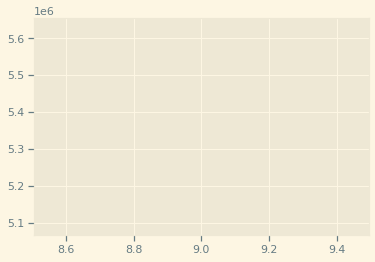

In [112]:
km_hr_pipes, km_hr_qual = get_pipes_qual(km_hr_train.loc[:, KM_HR_PREDICTORS], (9, 9))
km_hr_pipe = km_hr_pipes[0]

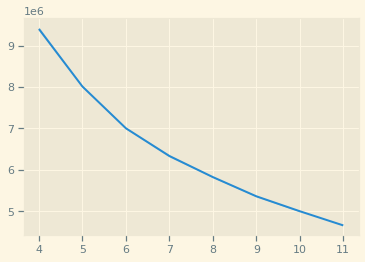

In [ ]:
# km_hr_pipes, km_hr_qual = get_pipes_qual(km_hr_train)
# plt.show()

In [ ]:
# km_hr_pipe = km_hr_pipes[2]

In [85]:
import pickle

storage = {
    'name': 'K-means clustering',
    'predictors': KM_HR_PREDICTORS,
    'clusters': 5,
    'pipeline': km_hr_pipe
}

with open('/content/drive/MyDrive/ITMO/3SEM/IndML/Lab1/pipe.pickle', 'wb') as write_file:
  pickle.dump(storage, write_file)
# with open('/content/drive/MyDrive/ITMO/3SEM/IndML/Lab1/pipe.pickle', 'rb') as read_file:
#   km_hr_pipe = pickle.load(read_file)['pipeline']

### On a map for one day

In [113]:
np.random.seed(RS)
km_dt = pd.to_datetime(np.random.choice(pd.unique(km_hr_train['date_time'].dt.date)))
# print(describe_datetime(km_dt))

In [125]:
def time_slider_choropleth_cls(data: pd.DataFrame, window = None, cmap_cls = "#272727"):
  """
  data - pandas DataFrame, should contain:
    lon-lat "coords_tuple",
    "publication" counts,
    and evenly distributed "date_time" for all coords
  window: int = None - how much timeslots to aggregate, if needed. default - no aggregation
  cmap - color map. Hex color code or function to get color palette of specified length
  """
  data_ = data.loc[:, ['coords_tuple', 'date_time', 'publication', 'cls']]

  # geojson
  points = pd.DataFrame(pd.unique(data_['coords_tuple']), columns=['coords_tuple']).reset_index()
  points['poly'] = points['coords_tuple'].apply(point_square)
  points['geometry'] = points['poly'].apply(Polygon)
  gdf_ = gpd.GeoDataFrame(points, crs="EPSG:4326")

  del points

  # style dict
  data_['opacity'] = MinMaxScaler().fit_transform(data_['publication'].to_numpy().reshape(-1,1))
  data_['opacity'] = data_['opacity'].apply(lambda x: 1 + 0 * x if x else 0)
  if window:
    s = data_.groupby('coords_tuple')['opacity'].rolling(window).agg('mean').fillna(0)
    s.index = data_.index
    data_['opacity'] = s
  max_color = data_['cls'].max() + 1
  colormap = cmap_cls(max_color) if callable(cmap_cls) else cmap_cls
  data_['color'] = colormap if isinstance(colormap, str) else itemgetter(*list(data_['cls']))(colormap)
  data_['u10_dt'] = (data_['date_time'].astype(int) // 10 ** 9).astype("U10")
  print(f'unique color: {list(pd.unique(data_["color"]))}')
  style_dict_ = {str(id): data_[data_['coords_tuple'] == coord]
                    .set_index('u10_dt')[['opacity', 'color']]
                    .to_dict('index')
                for (id, (coord)) in gdf_['coords_tuple'].iteritems()}
  
  # map
  m = folium.Map(location=(59.93863, 30.31413), tiles=None, zoom_start=12)
  folium.TileLayer("stamentoner").add_to(m)

  name = f'Choropleth {data["date_time"].min()} = {data["date_time"].max()}'

  g = TimeSliderChoropleth(
      gdf_.to_json(),
      styledict=style_dict_,
      name = name
  ).add_to(m)
  folium.LayerControl(collapsed=False).add_to(m)
  
  return m

def one_day_kmeans_map(data, dt):
  data_ = data[data['date_time'].dt.date == dt.date()].reset_index()

  # prepare index
  ind_dates = pd.Series(pd.date_range(dt.date(), dt.date() + pd.DateOffset(hours=23), freq='1H'), name='date_time')
  ind_coords = pd.Series(pd.unique(data_['coords_tuple']), name='coords_tuple')

  # failed to reindex with multiindex, so merge in tuple
  # data_ = data_.groupby(['coords_tuple', 'date_time', 'cls']).agg(publication=('publication', 'sum'),).reset_index()
  # data_['index'] = list(data_[['coords_tuple', 'date_time', 'cls']].itertuples(index=False))
  data_['index'] = list(data_[['coords_tuple', 'date_time']].itertuples(index=False))
  data_ = data_.set_index('index')
  # day_info = day_info.set_index(['coords_tuple', 'date_time'])
  data_ = data_.reindex(list(pd.merge(ind_coords, ind_dates, how='cross').itertuples(index=False)))
  data_ = data_.loc[:, ['publication', 'cls']]
  data_ = data_.reset_index()
  data_['coords_tuple'], data_['date_time'] = zip(*list(data_['index']))
  data_.drop(['index'], axis='columns', inplace=True)
  data_['publication'] = data_['publication']#.fillna(0, axis='index').astype(int)
  data_['cls'] = data_['cls'].fillna(0, axis='index').astype(int)
  return data_

In [126]:
km_hr_train['cls'] = km_hr_pipe.predict(km_hr_train.loc[:, KM_HR_PREDICTORS].astype('float'))
km_hr_d_train = one_day_kmeans_map(km_hr_train, km_dt)
time_slider_choropleth_cls(km_hr_d_train, cmap_cls = lambda n: sns.color_palette('tab10', n).as_hex())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: FutureWarning: casting datetime64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.


unique color: ['#1f77b4', '#d62728', '#e377c2', '#8c564b']


In [118]:
km_hr_d_train[['cls']].value_counts()

cls
0      42027
5       3381
6       3309
3        291
dtype: int64

## Agglom. clustering

In [ ]:
AGCLUSTERS_GRID = np.linspace(2, 7, 6).astype('int')

agc_pipes = []
agc_qual = []

for cl in AGCLUSTERS_GRID:
  agc_pipeline = make_pipeline(StandardScaler(), AgglomerativeClustering(cl))
  agc_pipeline.fit(train.loc[:, ['lon', 'lat'] + META].astype('float'))
  qual.append(agc_pipeline['agglomerativeclustering'].inertia_)
  agc_pipes.append(agc_pipeline)

sns.lineplot(x=AGCLUSTERS_GRID, y=agc_qual)

MemoryError: ignored